In [48]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import mapclassify
import geoplot
import plotly.express as px

In [49]:
od_file = "DataDonwloaded/EOD_from_Louiselle/EOD/mtl18pv2c.csv"
od = pd.read_csv(od_file,delimiter=';',low_memory=False)

In [50]:
trip_file = "mtq/output_trips.csv.gz"
trip = pd.read_csv(trip_file,delimiter=";",compression='gzip')

In [51]:
person_attrib = pd.read_csv('mtq/personAttributes.csv', index_col=0)


In [52]:
geo_filter = gpd.read_file('popgen_input_data/output/geoFilter.shp')
geo_filter.CTUID = geo_filter.CTUID.astype(float).astype(str)

In [53]:
pd.set_option('display.max_columns',None)
od[od.srlog.astype(float)==4620755.02].head(1)

,ipere,idu,version,media_int,provenance,date_int,deb_interv,nolog,tlog,nbper,nbveh,revenu,langue,nmodif_ass,incaplogi,xmtmlog,ymtmlog,r6log,r8log,rmrlog,arrlog,sdrlog,srlog,sdomi65,smlog,cplog,agr_domi,jour,sem,facmen,facmen18,noper,tper,clepersonne,sexe,age,grpage,incap,percond,abon_ap,abon_vls,passetc,occper,tele_trav,lieuocc,xmtmocc,ymtmocc,rmrocc,arrocc,sdrocc,srocc,smocc,cpocc,l_id_local,mobil,facper,facper18,facdep18,cledeplacement,nodep,no_rep,hredep,ghredep,motif,motif_grp,date_dpl,jour_dpl,mode1,mode2,mode3,mode4,mode5,mode6,mode7,mode8,seq_modes,covoiturage,pers_auto,auto_ap,velo_ls,station_p,pont1,pont2,mode_exclu,lig1,lig2,lig3,lig4,lig5,lig_imp,metro1,metro2,metro3,metro4,gare1,gare2,gare3,gare4,aut1,aut2,aut3,aut4,aut5,aut6,aut7,aut8,aut9,aut10,aut11,aut12,trace1,trace2,trace3,trace4,trace5,dist,agr_ori,xmtmori,ymtmori,xlonori,ylatori,r6orig,r8orig,arrori,sdrori,srori,sorig65,smori,cpori,o_id_local,inodo,loccodeo,xyo,agr_des,xmtmdes,ymtmdes,xlondes,ylatdes,r6dest,r8dest,arrdes,sdrdes,srdes,sdest65,smdes,cpdes,d_id_local,inodd,loccoded,xyd,Depl_Excl,nbjct,typjct1,typjct1_98,stajct1,agr_jct1,j_id_local1,xmtmjct1,ymtmjct1,xlonjct1,ylatjct1,r6jct1,r8jct1,arrjct1,sdrjct1,srjct1,sjonc65_1,smjct1,inodj1,loccodej1,nchangzone1,xmtmjct2,ymtmjct2,xlonjct2,ylatjct2,r6jct2,r8jct2,arrjct2,sdrjct2,srjct2,sjonc652,smjct2,inodj2,loccodej2,nchangzone2,tc,actif,autre_mot,motorise,metro,stm,rtl,stl,auto,autop,autoc,mauto,autrebus,busscol,taxi,train,a_pied,moto,velo,cit,au_mode,tr_adap,indet1
89088,89089,2610540101,18.2c,T,F,2018-09-12,03:04,261054,1.0,3,2,2,1,0,2,262019,5027546,5,8,462,NaN,2471083,4620755.02,61,573,J7V0E2,A,2,37,"18,23","18,79",1,1.0,2610541,2,50,11,4,1,2,2,9,2,2,4,290977.0,5032731.0,462.0,LCH,2466023.0,4620391.0,129.0,NaN,3,1,"20,4","20,49","20,73",26105411.0,1.0,1.0,1530.0,5.0,9.0,6.0,2018-09-11,Mardi,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.0,2.0,4.0,4.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,510.0,507.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,"11,97",A,262019.0,5027546.0,"-74,046324","45,386548",5.0,8.0,NaN,2471083.0,4620755.02,61.0,573.0,J7V0E2,1.0,1.0,12471083.0,0.0,G,253877.0,5018773.0,"-74,14939","45,307063",5.0,8.0,NaN,2471040.0,4621003.0,71.0,571.0,NaN,6.0,1.0,12471040.0,0.0,0,NaN,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,X,NaN,NaN,NaN,NaN,X,NaN,X,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
od['facper18'] = od["facper18"].str.replace(',','.').astype(float)
od['facper'] = od["facper"].str.replace(',','.').astype(float)
od['facmen'] = od["facmen"].str.replace(',','.').astype(float)
od['facmen18'] = od["facmen18"].str.replace(',','.').astype(float)
od['facdep18'] = od['facdep18'].str.replace(',','.').astype(float)

In [55]:

od['id_personne'] = od.nolog.astype(str)+"_"+od.noper.astype(str)
od['id_deplacement'] = od.nolog.astype(str)+"_"+od.noper.astype(str)+"_"+od.nodep.astype(str)


house_coord = gpd.GeoDataFrame(od[['nolog','xmtmlog','ymtmlog']], geometry=gpd.points_from_xy(od.xmtmlog,od.ymtmlog),crs='epsg:32188')
house_coord = gpd.sjoin(house_coord,geo_filter,how='left')
od = pd.merge(od,house_coord[['nolog','DAUID','CTUID']],left_on='nolog',right_on='nolog',how = 'left')
od = od.rename(columns = {'DAUID':'DAUID_log','CTUID':'CTUID_log'})

/Users/ashrafzaman/opt/anaconda3/envs/newMatsimPipeline/lib/python3.9/site-packages/geopandas/array.py:275: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  return GeometryArray(vectorized.points_from_xy(x, y, z), crs=crs)


In [56]:
od.keys().__contains__('srlog')

True

In [57]:
zone8 = od[od.nodep.notnull()][['srori','r8orig']].astype(float).astype(str)
zone8 = zone8.rename(columns = {'srori':'CTUID','r8orig':'r8'})
zone8des = od[od.nodep.notnull()][['srdes','r8dest']].astype(float).astype(str)
zone8des = zone8des.rename(columns = {'srdes':'CTUID','r8dest':'r8'})
zone8log = od[['srlog','r8log']].astype(float).astype(str)
zone8log = zone8log.rename(columns = {'srlog':'CTUID','r8log':'r8'})
zone8 = pd.concat([zone8,zone8des,zone8log]).drop_duplicates()
del zone8des 
del zone8log

In [58]:
zone6 = od[od.nodep.notnull()][['srori','r6orig']].astype(float).astype(str)
zone6 = zone6.rename(columns = {'srori':'CTUID','r6orig':'r6'})
zone6des = od[od.nodep.notnull()][['srdes','r6dest']].astype(float).astype(str)
zone6des = zone6des.rename(columns = {'srdes':'CTUID','r6dest':'r6'})
zone6log = od[['srlog','r6log']].astype(float).astype(str)
zone6log = zone6log.rename(columns = {'srlog':'CTUID','r6log':'r6'})
zone6 = pd.concat([zone6,zone6des,zone6log]).drop_duplicates()
del zone6des
del zone6log

In [59]:
geo_filter = pd.merge(geo_filter,zone8,on='CTUID',how='left')

In [60]:
geo_filter = pd.merge(geo_filter,zone6,on='CTUID',how='left')

In [61]:
geo_filter.to_file('output_shp/geo_filter.shp')
region8 = geo_filter.dissolve(by = 'r8')
region6 = geo_filter.dissolve(by = 'r6')
region6.to_file('output_shp/r6.shp')
region8.to_file('output_shp/r8.shp')
del zone6
del zone8

/Users/ashrafzaman/opt/anaconda3/envs/newMatsimPipeline/lib/python3.9/site-packages/geopandas/io/file.py:299: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


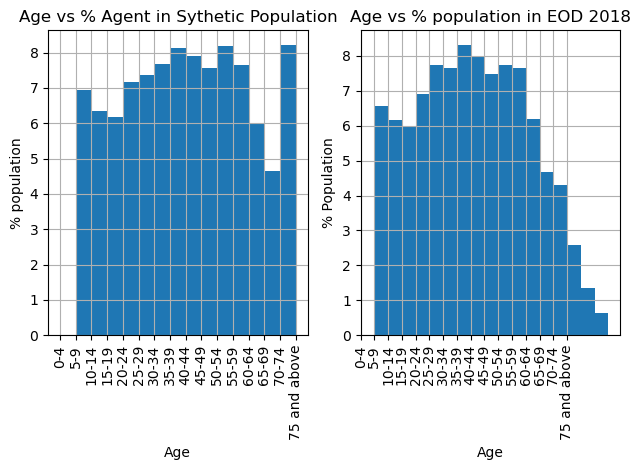

In [62]:
fig, axes = plt.subplots(nrows=1, ncols=2)
person_attrib['w']=1/len(person_attrib.age)*100
person_attrib.age.hist(ax = axes[0],bins = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16],weights = person_attrib.w)
axes[0].set_xticks([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16])
axes[0].set_xticklabels(['0-4','5-9','10-14','15-19','20-24','25-29','30-34','35-39','40-44','45-49','50-54','55-59','60-64','65-69','70-74','75 and above'],rotation=90)
axes[0].set_xlabel('Age')
axes[0].set_ylabel('% population')
axes[0].set_title('Age vs % Agent in Sythetic Population')
od_act = od[od.nodep.notna()]
#od_act = od
od_mem = od_act[['nolog','noper','age','sexe','facper','facper18']].drop_duplicates()
od_mem["age"].plot.hist(ax =axes[1], weights=od_mem["facper18"]/od_mem["facper18"].sum()*100,bins=[5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80,85,90],title = 'Age vs % population in EOD 2018')
axes[1].set_xticks([0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75])
axes[1].set_xticklabels(['0-4','5-9','10-14','15-19','20-24','25-29','30-34','35-39','40-44','45-49','50-54','55-59','60-64','65-69','70-74','75 and above'],rotation=90)
axes[1].set_xlabel('Age')
axes[1].set_ylabel('% Population')
axes[1].grid(True)
fig.tight_layout()

In [63]:
del fig,axes,od_act

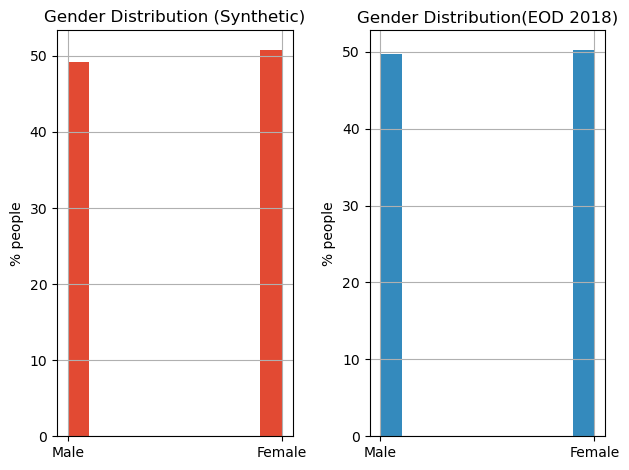

In [64]:
fig, axes = plt.subplots(nrows=1, ncols=2)
colors = ["#e24a33", "#348abd"]
plt.setp(axes, xticks=[1, 2], xticklabels=['Male', 'Female'],ylabel = '% people')
ax = person_attrib.sex.hist(ax=axes[0],weights = person_attrib.w,color = colors[0]).plot()
axes[0].set_title('Gender Distribution (Synthetic)')
ax = od_mem.sexe.hist(ax=axes[1],weights = od_mem.facper/od_mem["facper"].sum()*100,color = colors[1]).plot()
axes[1].set_title('Gender Distribution(EOD 2018)')
fig.tight_layout()

In [65]:
del fig,axes,colors,od_mem

In [66]:
fac1 = trip[['end_facility_id','end_x','end_y']]
fac1 = fac1.rename({'end_facility_id':'facility_id','end_x':'x','end_y':'y'},axis = 1)
fac2 = trip[['start_facility_id','start_x','start_y']]
fac2 = fac2.rename({'start_facility_id':'facility_id','start_x':'x','start_y':'y'},axis = 1)

In [67]:
fac = pd.concat([fac1.drop_duplicates(),fac2.drop_duplicates()])
fac = fac.drop_duplicates()

In [68]:
fac_shp = gpd.GeoDataFrame(fac, geometry=gpd.points_from_xy(fac.x, fac.y),crs='epsg:32188')

a = gpd.sjoin(fac_shp,geo_filter,how='left')

/Users/ashrafzaman/opt/anaconda3/envs/newMatsimPipeline/lib/python3.9/site-packages/geopandas/array.py:275: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  return GeometryArray(vectorized.points_from_xy(x, y, z), crs=crs)


epsg:32188


/Users/ashrafzaman/opt/anaconda3/envs/newMatsimPipeline/lib/python3.9/site-packages/geopandas/io/file.py:299: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/2929920207.py:7: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  b.to_file('output_shp/fac.shp')


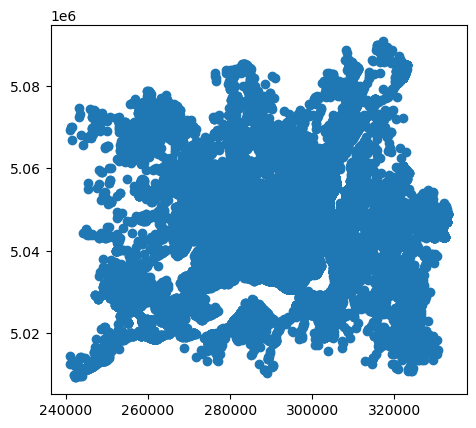

In [69]:
a.set_crs('epsg:32188')

print(fac_shp.crs)
a.facility_id=a.facility_id.astype(str)
b=a[a.CTUID.notnull()]
b.plot()
b.to_file('output_shp/fac.shp')


In [70]:
b[['facility_id','CTUID']].to_csv('mtq/facToCTUID.csv',index = False)

In [71]:
trip.start_facility_id = trip.start_facility_id.astype(str)
trip.end_facility_id = trip.end_facility_id.astype(str)
trip = trip.merge(a[['facility_id','DAUID','CTUID','region','geo','r8','r6']],left_on='start_facility_id',right_on='facility_id',how='left')
trip = trip.rename({'DAUID':'DAUID_start','CTUID':'CTUID_start','geo':'geo_start','region':'region_start','r8':'r8_start','r6':'r6_start'},axis=1)
trip = trip.drop(columns=['facility_id'])

In [72]:
trip = trip.merge(a[['facility_id','DAUID','CTUID','region','geo','r8','r6']],left_on='end_facility_id',right_on='facility_id',how='left')
trip = trip.rename({'DAUID':'DAUID_end','CTUID':'CTUID_end','geo':'geo_end','region':'region_end','r8':'r8_end','r6':'r6_end'},axis=1)
trip = trip.drop(columns=['facility_id'])


In [73]:
trip['r6_r6'] = trip['r6_start'].astype(str)+'_'+trip['r6_end'].astype(str)
trip['r8_r8'] = trip['r8_start'].astype(str)+'_'+trip['r8_end'].astype(str)

In [74]:
trip = trip.merge(person_attrib,left_on='person',right_on='person_id',how = 'left')
del fac1,fac2,fac

In [75]:
age_bean = pd.DataFrame({'age':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16],'age_bean':['0-4','5-9','10-14','15-19','20-24','25-29','30-34','35-39','40-44','45-49','50-54','55-59','60-64','65-69','70-74','75 and above']})

In [76]:
trip = trip.merge(age_bean,left_on = 'age',right_on = 'age',how = 'left')

In [77]:
act_def = pd.DataFrame({'motif_grp':[1,2,3,4,5,6,7,8],'act_lbl':['work','education','home','leisure','shop','other','no_movement','indeter']}) 
od = od.merge(act_def,left_on="motif_grp",right_on='motif_grp',how = 'left')

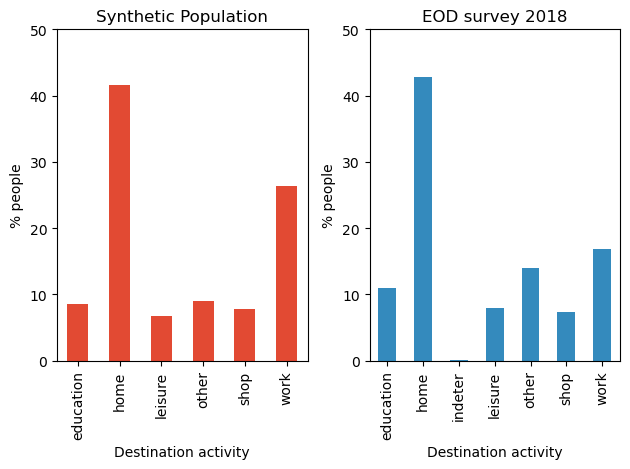

In [78]:
fig, axes = plt.subplots(nrows=1, ncols=2)

colors = ["#e24a33", "#348abd"]
trip['w'] = 1/len(trip.age)*100
trip[['end_activity_type','w']].groupby('end_activity_type')['w'].sum().plot.bar(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'Destination activity')
od_active = od[od.motif_grp != 7]
od_active = od_active[od_active.nodep.notnull()]
od_active['tw'] = od_active.facdep18/od_active.facdep18.sum()*100
od_active['w'] = 1/len(od_active['age'])*100
od_active[['act_lbl','tw']].groupby('act_lbl')['tw'].sum().plot.bar(ax = axes[1],color = colors[1],title = 'EOD survey 2018',legend = False,xlabel = 'Destination activity')
plt.setp(axes, yticks=[0,10, 20,30,40,50],ylabel = '% people')
# axes[1].set_xticks([0,1,2,3,4,5,6,7,8])
# axes[1].set_xticklabels(['work','study','home','leisure','shopping','other','not declared'])
fig.tight_layout()


In [79]:
trip['dep_time_hr'] = trip.dep_time.apply(lambda x:int(x.split(':')[0])+int(x.split(':')[1])/60)

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/3147641735.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['tw'] = od_active.facper18/od_active.facper18.sum()*100
/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/3147641735.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['w'] = 1/len(od_active['age'])*100


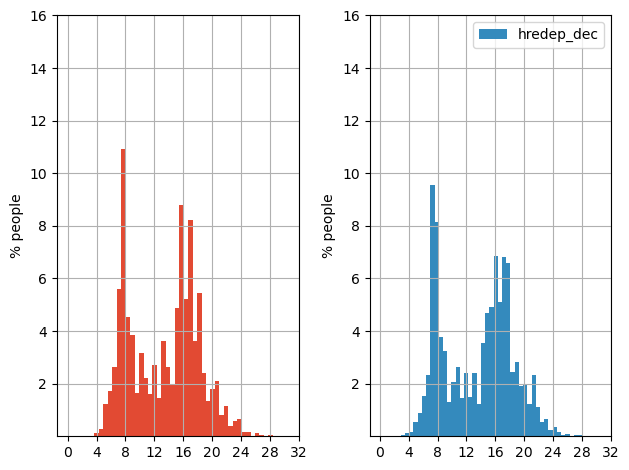

In [80]:
fig, axes = plt.subplots(nrows=1, ncols=2)

colors = ["#e24a33", "#348abd"]
trip['w'] = 1/len(trip.age)*100
trip.dep_time_hr.plot.hist(bins = 48,weights = trip['w'],ax = axes[0],color = colors[0])
od_active = od[od.nodep.notnull()]
od_active['tw'] = od_active.facper18/od_active.facper18.sum()*100
od_active['w'] = 1/len(od_active['age'])*100
od_active = od_active[['hredep','tw','w']]
od_active = od_active.dropna()
od_active['hredep_dec'] = ((od_active.hredep).astype(int)/100).astype(int)+od_active.hredep.astype(int)%100/60
od_active[['hredep_dec']].plot.hist(bins = 48,weights = od_active['tw'],ax = axes[1],color = colors[1])
plt.setp(axes, xticks=[0,4,8,12,16,20,24,28,32], yticks = [2,4,6,8,10,12,14,16],ylabel = '% people')
fig.tight_layout()
axes[0].grid(True)
axes[1].grid(True)


In [81]:
trip_pop = pd.read_csv("/Users/ashrafzaman/matsim_pipelines/mtq/trips.csv")
len(trip_pop.personId)
trip_pop['dep_time'] = trip_pop.dep_time/3600

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/3689376721.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['tw'] = od_active.facdep18/od_active.facdep18.sum()*100
/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/3689376721.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['w'] = 1/len(od_active['age'])*100


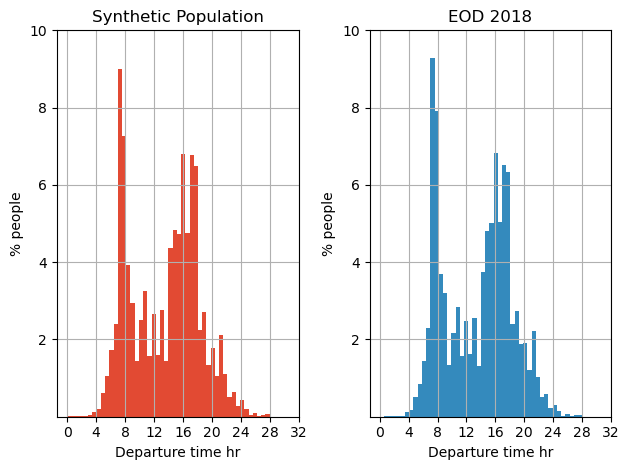

In [82]:
fig, axes = plt.subplots(nrows=1, ncols=2)
colors = ["#e24a33", "#348abd"]
trip_pop['w'] = 1/410337*100
trip_pop.dep_time.plot.hist(title = 'Synthetic Population',bins = 48,weights = trip_pop['w'],ax = axes[0],color = colors[0])
od_active = od[od.nodep.notnull()]
od_active['tw'] = od_active.facdep18/od_active.facdep18.sum()*100
od_active['w'] = 1/len(od_active['age'])*100
od_active = od_active[['hredep','tw','w']]
od_active = od_active.dropna()
od_active['hredep_dec'] = ((od_active.hredep).astype(int)/100).astype(int)+od_active.hredep.astype(int)%100/60
od_active[['hredep_dec']].plot.hist(title = 'EOD 2018',bins = 48,weights = od_active['w'],ax = axes[1],color = colors[1],legend = False)
plt.setp(axes, xticks=[0,4,8,12,16,20,24,28,32], yticks = [2,4,6,8,10],ylabel = '% people',xlabel='Departure time hr')
fig.tight_layout()
axes[0].grid(True)
axes[1].grid(True)

#FRQ and NSearch 

In [83]:
trip_pop['mode'].value_counts()

car              239314
pt                62436
car_passenger     52615
walk              45057
bike              10915
Name: mode, dtype: int64

In [84]:
mode_def = pd.DataFrame({'mode':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18],'mode_lbl':['car','car_passenger','pt','pt','pt','pt','pt','pt','pt','pt','car_passenger','car_passenger','bike','walk','pt','pt','car','car']}) 
od_mode = od[od.nodep.notnull()].merge(mode_def,left_on="mode1",right_on='mode',how = 'left')
od_mode = od_mode.rename({'mode_lbl':'mode1_lbl'},axis = 1)
od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode2",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode2_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode3",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode3_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode4",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode4_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode5",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode5_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode6",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode6_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode7",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode7_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode = od_mode.merge(mode_def,left_on="mode8",right_on='mode',how = 'left')
# od_mode = od_mode.rename({'mode_lbl':'mode8_lbl'},axis = 1)
# od_mode.drop(columns=['mode'],inplace=True)

# od_mode[od_mode['mode8'].notna()].head()

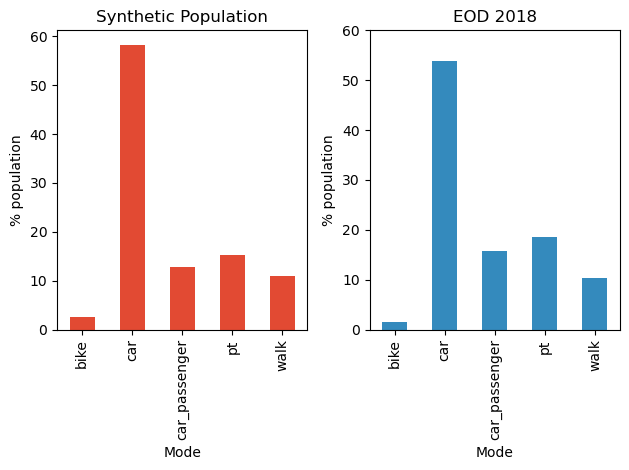

In [85]:
fig, axes = plt.subplots(nrows=1, ncols=2)
colors = ["#e24a33", "#348abd"]
trip_pop[['mode','w']].groupby('mode')['w'].sum().plot.bar(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'Mode',ylabel = '% population')
od_mode['tw'] = od_mode.facdep18/od_mode.facdep18.sum()*100
od_mode['w'] = 1/len(od_mode['age'])*100
od_mode[['mode1_lbl','tw']].groupby('mode1_lbl')['tw'].sum().plot.bar(ax = axes[1],color = colors[1],title = 'EOD 2018',legend = False,xlabel = 'Mode',ylabel = '% population')
plt.setp(axes,  yticks = [0,10,20,30,40,50,60])
fig.tight_layout()


In [86]:
del od_mode

<AxesSubplot: >

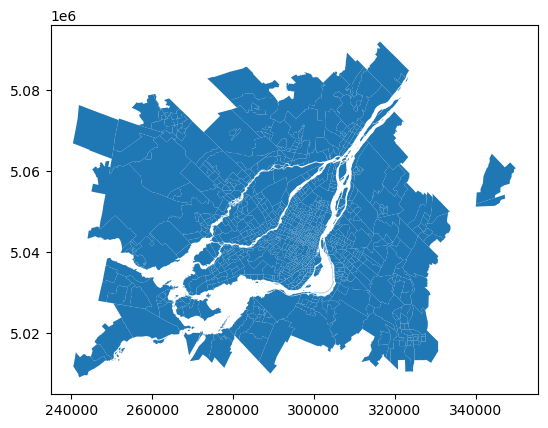

In [87]:
cma_loc = 'DataDonwloaded/Shapes/lct_000b21a_e/lct_000b21a_e.shp'

cma = gpd.read_file(cma_loc)

cma.to_crs(epsg = 32188, inplace = True)
minx=232018.46167784795
miny=4998356.443671201
maxx=341483.2997932121
maxy=5097791.967859513
cma = cma.cx[minx:maxx,miny:maxy]
len(cma)
cma.plot()



In [88]:



prod_synthetic_weight = trip[trip.end_activity_type=='work'][['CTUID_start','w']].groupby('CTUID_start').sum()
att_synthetic_weight = trip[trip.end_activity_type=='work'][['CTUID_end','w']].groupby('CTUID_end').sum()




prod_region = geo_filter[geo_filter.CTUID.isin(trip[['CTUID_start','w']].groupby('CTUID_start').sum().index)]
prod_region = prod_region.merge(prod_synthetic_weight,left_on='CTUID',right_index=True, how = 'left')
#att_region = cma[cma.CTUID.isin(trip[['CTUID_end','w']].groupby('CTUID_end').sum().index)]

att_region = geo_filter[geo_filter.CTUID.isin(trip[['CTUID_end','w']].groupby('CTUID_end').sum().index)]
att_region = att_region.merge(att_synthetic_weight,left_on='CTUID',right_index=True, how = 'left')


In [89]:
prod_synthetic_weight

,w
CTUID_start,
4620001.0,0.019812
4620002.0,0.064958
4620003.0,0.037539
4620004.0,0.022450
4620005.0,0.006870
...,...
4622303.0,0.000031
4622304.0,0.000828
4622400.0,0.005275


In [90]:
att_synthetic_weight

,w
CTUID_end,
4620001.0,0.000491
4620002.0,0.001472
4620003.0,0.002331
4620004.0,0.014108
4620005.0,0.002454
...,...
4622303.0,0.000521
4622304.0,0.000031
4622400.0,0.001625


(235696.47769790184, 338473.05298650963, 5004803.281957125, 5096241.339401737)

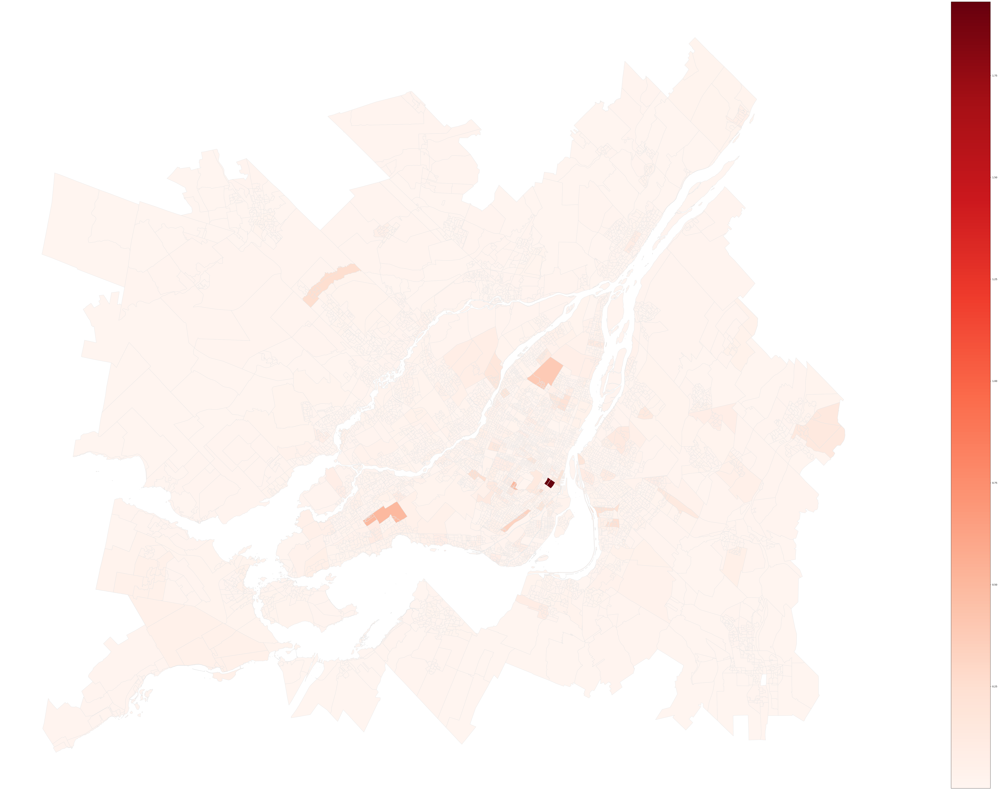

In [91]:
fig, ax = plt.subplots(1, figsize=(100,60))
prod_region.plot(column='w', cmap='Reds', linewidth=1, ax=ax, edgecolor='0.9', legend = True)
ax.axis('off')

(235696.47769790184, 338473.05298650963, 5004803.281957125, 5096241.339401737)

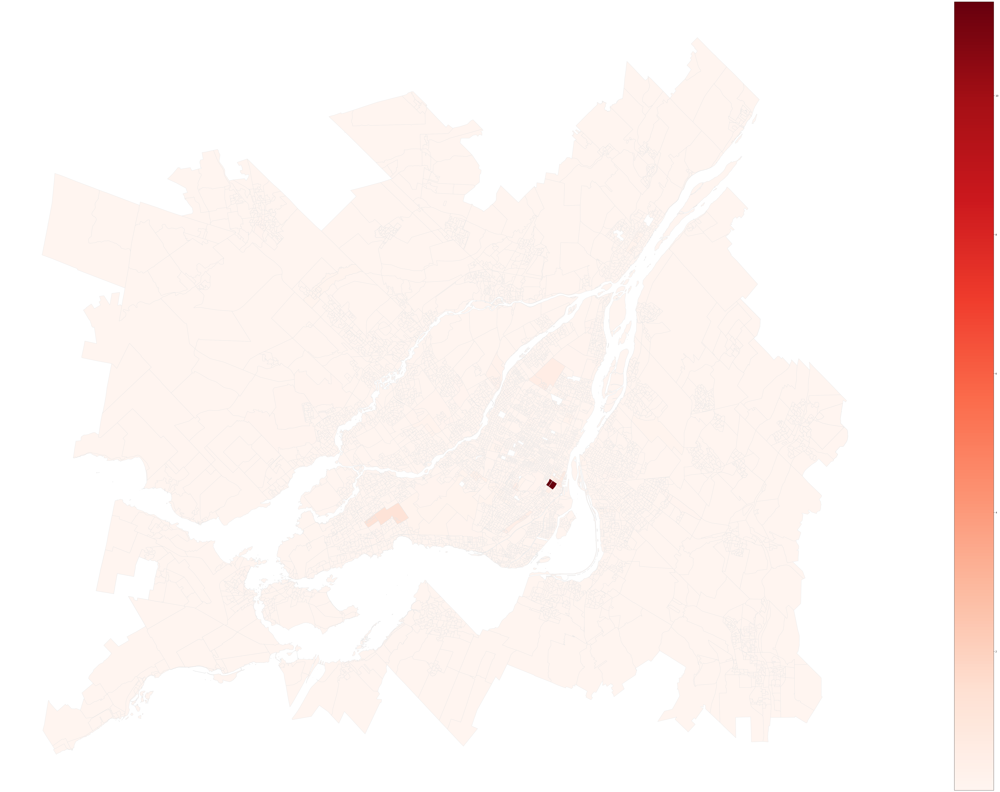

In [92]:
fig, ax = plt.subplots(1, figsize=(100,60))
att_region.plot(column='w', cmap='Reds', linewidth=1, ax=ax, edgecolor='0.9', legend = True)
ax.axis('off')

In [93]:
od_active = od[od.nodep.notnull()]
od_active['tw'] = od_active.facdep18/od_active.facdep18.sum()*100
od_active['w'] = 1/len(od_active['age'])*100

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/2975299196.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['tw'] = od_active.facdep18/od_active.facdep18.sum()*100
/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_52590/2975299196.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['w'] = 1/len(od_active['age'])*100


(235696.47769790184, 338473.05298650963, 5004803.281957125, 5096241.339401737)

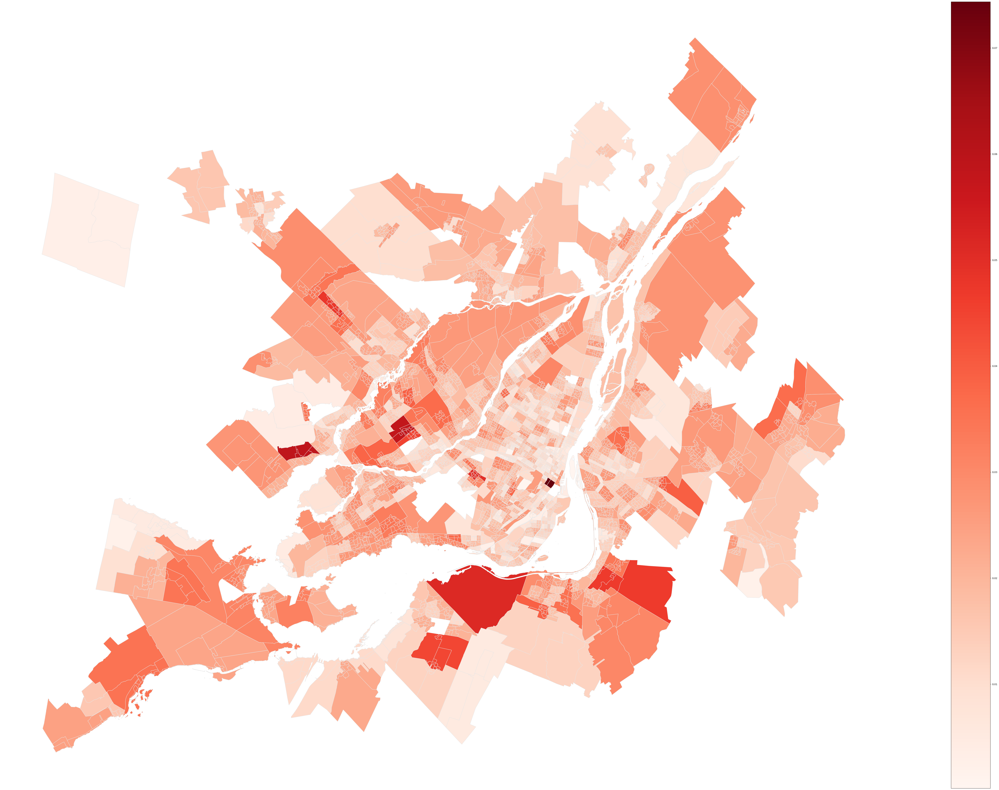

In [95]:
od_production = od_active[od_active.motif_grp==1][['srori','tw']].dropna()
od_production.srori=od_production.srori.astype(float).astype(str)
od_production = od_production.groupby('srori').sum()
od_production_shp = geo_filter[geo_filter.CTUID.isin(od_production.index)]
od_production_shp = od_production_shp.merge(od_production,left_on = 'CTUID',right_index = True, how = 'left')
fig, ax = plt.subplots(1, figsize=(100,60))
od_production_shp.plot(column='tw', cmap='Reds', linewidth=1, ax=ax, edgecolor='0.9', legend = True)
ax.axis('off')

(235794.48814222382, 338468.3858224943, 5004803.281957125, 5096241.339401737)

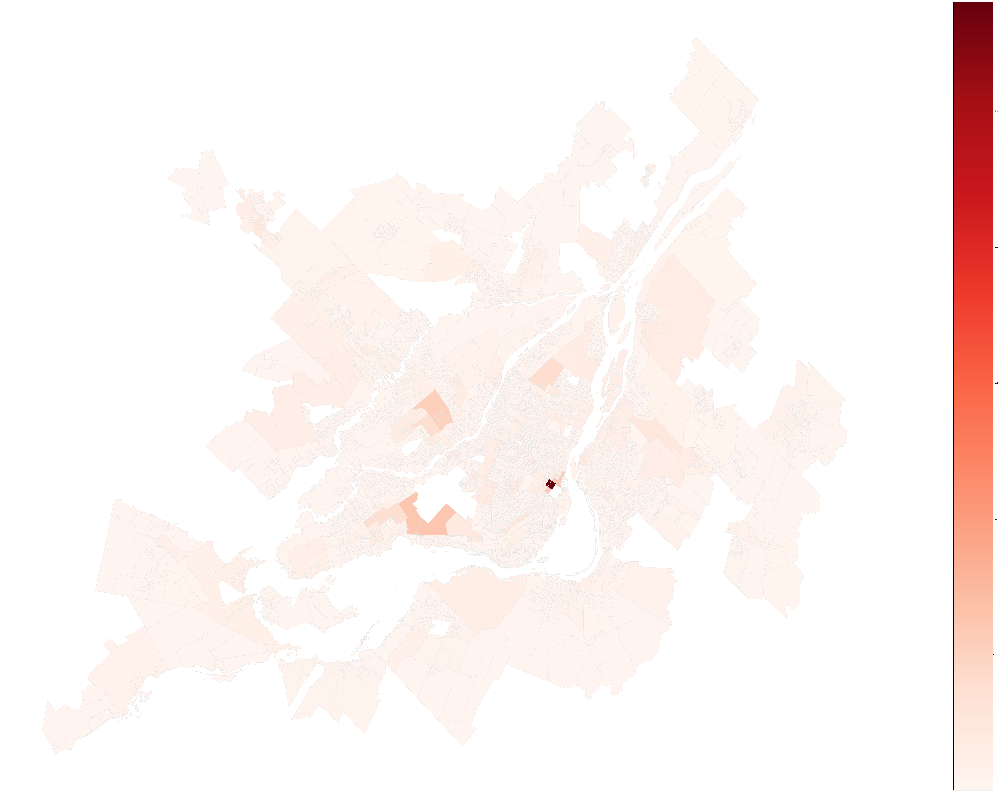

In [46]:
od_attraction = od_active[od_active.motif_grp==1][['srdes','tw']]
od_attraction.srdes = od_attraction.srdes.astype(float).astype(str)
od_attraction = od_attraction.groupby('srdes').sum()
od_attraction_shp = geo_filter[geo_filter.CTUID.isin(od_attraction.index)]
od_attraction_shp = od_attraction_shp.merge(od_attraction,left_on = 'CTUID',right_index = True, how = 'left')
fig, ax = plt.subplots(1, figsize=(100,60))
od_attraction_shp.plot(column='tw', cmap='Reds', linewidth=1, ax=ax, edgecolor='0.9', legend = True)
ax.axis('off')

In [47]:
od_active.keys().__contains__('r8orig')

True

In [48]:
od_active['r8_r8'] = od_active['r8orig'].astype(str)+'_'+od_active['r8dest'].astype(str)
od_active['r6_r6'] = od_active['r6orig'].astype(str)+'_'+od_active['r6dest'].astype(str)

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/3356103500.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['r8_r8'] = od_active['r8orig'].astype(str)+'_'+od_active['r8dest'].astype(str)
/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/3356103500.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['r6_r6'] = od_active['r6orig'].astype(str)+'_'+od_active['r6dest'].astype(str)


/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/4195179225.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trip_ =trip_[trip.r6_end.notnull()]


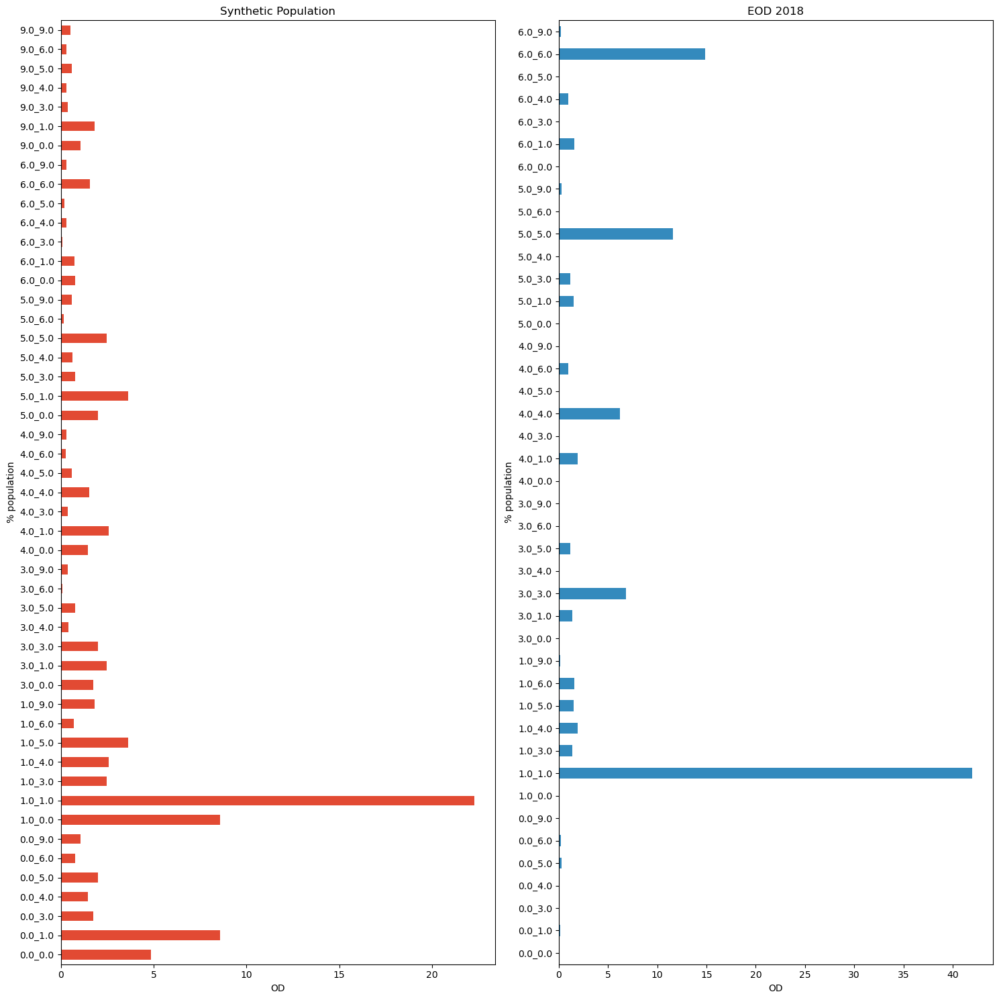

In [49]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 15))

colors = ["#e24a33", "#348abd"]
trip_ =trip[trip.r6_start.notnull()]
trip_ =trip_[trip.r6_end.notnull()]
trip_[['r6_r6','w']].groupby('r6_r6')['w'].sum().plot.barh(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'OD',ylabel = '% population')

od_active[['r6_r6','tw']].groupby('r6_r6')['tw'].sum().plot.barh(ax = axes[1],color = colors[1],title = 'EOD 2018',legend = False,xlabel = 'OD',ylabel = '% population')
#plt.setp(axes,  yticks = [0,10,20,30,40,50,60])
fig.tight_layout()

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/240002442.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trip_ =trip_[trip.r8_end.notnull()]


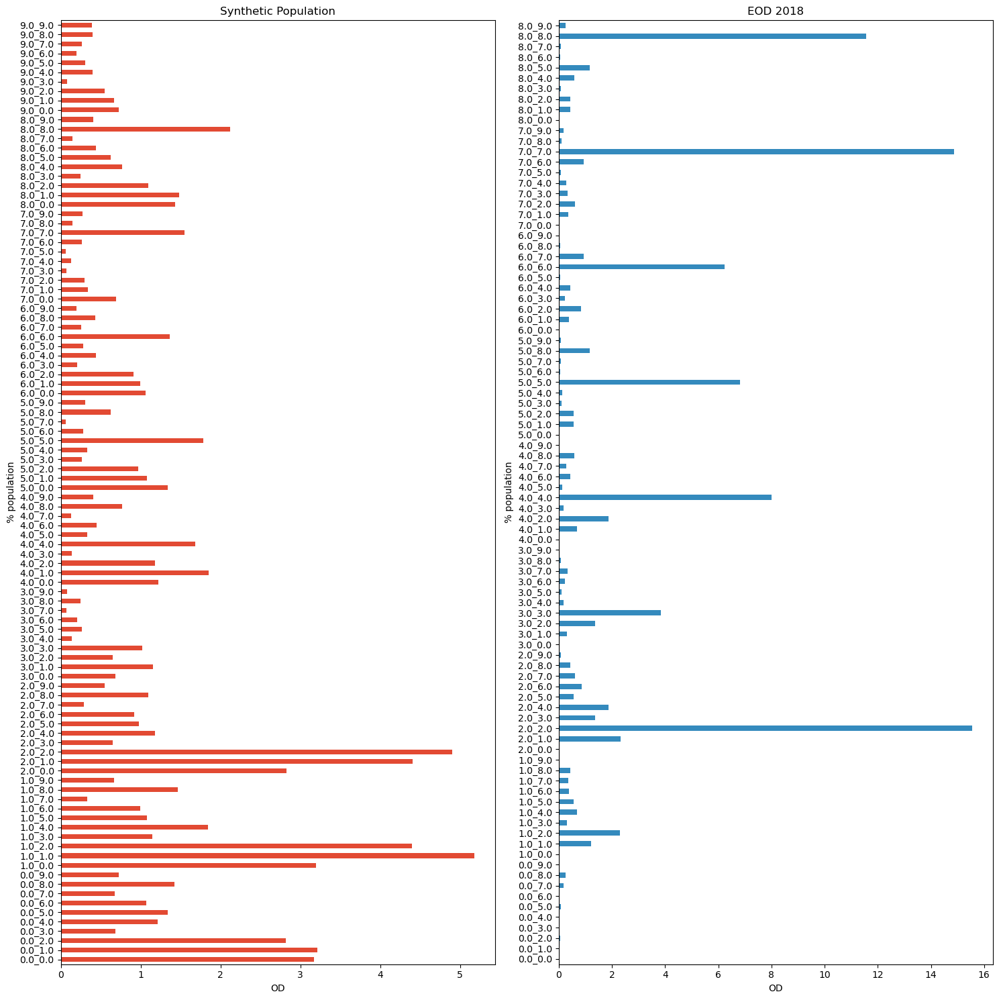

In [50]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 15))
colors = ["#e24a33", "#348abd"]
trip_ =trip[trip.r8_start.notnull()]
trip_ =trip_[trip.r8_end.notnull()]
trip_[['r8_r8','w']].groupby('r8_r8')['w'].sum().plot.barh(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'OD',ylabel = '% population')
od_active[['r8_r8','tw']].groupby('r8_r8')['tw'].sum().plot.barh(ax = axes[1],color = colors[1],title = 'EOD 2018',legend = False,xlabel = 'OD',ylabel = '% population')
#plt.setp(axes,  yticks = [0,10,20,30,40,50,60])
fig.tight_layout()

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/2686055661.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trip_ =trip_[trip.r8_end.notnull()]


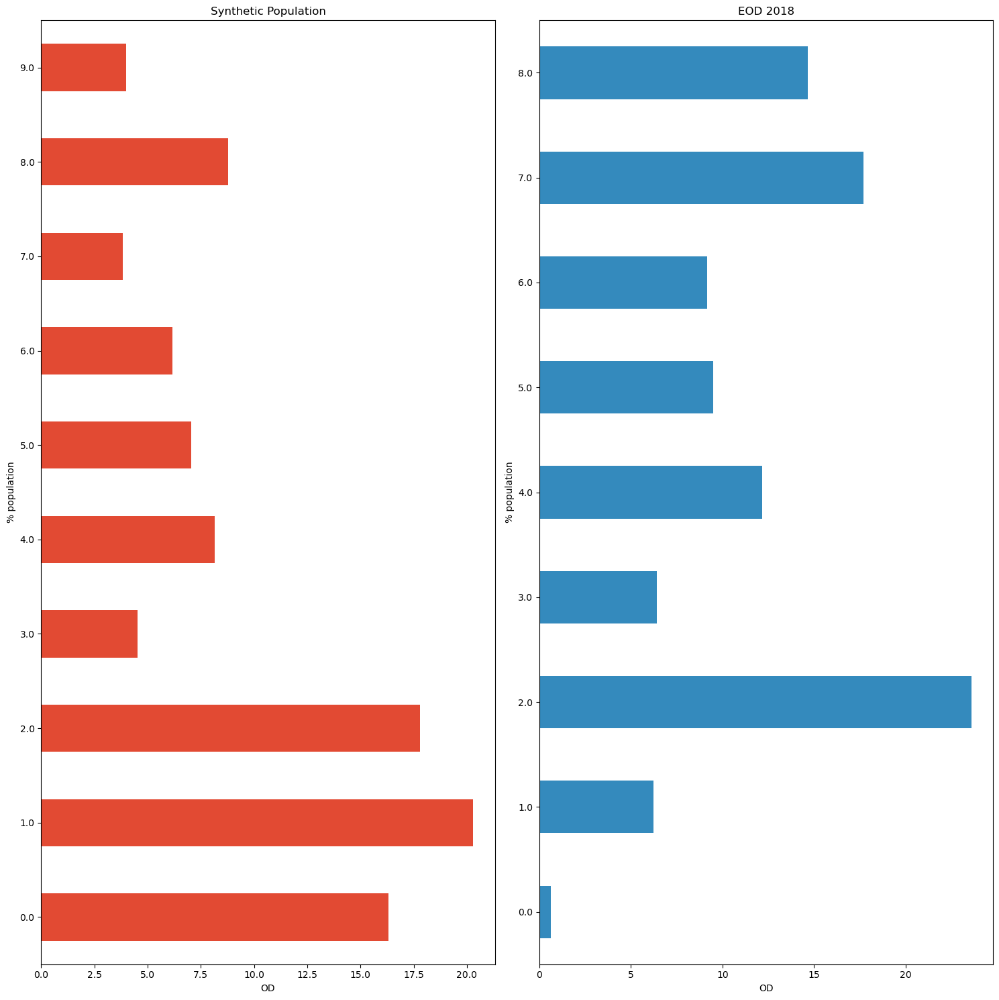

In [51]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 15))
colors = ["#e24a33", "#348abd"]
trip_ =trip[trip.r8_start.notnull()]
trip_ =trip_[trip.r8_end.notnull()]
trip_[['r8_start','w']].groupby('r8_start')['w'].sum().plot.barh(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'OD',ylabel = '% population')
od_active[['r8orig','tw']].groupby('r8orig')['tw'].sum().plot.barh(ax = axes[1],color = colors[1],title = 'EOD 2018',legend = False,xlabel = 'OD',ylabel = '% population')
#plt.setp(axes,  yticks = [0,10,20,30,40,50,60])
fig.tight_layout()

/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/276821200.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trip_ =trip_[trip.r8_end.notnull()]


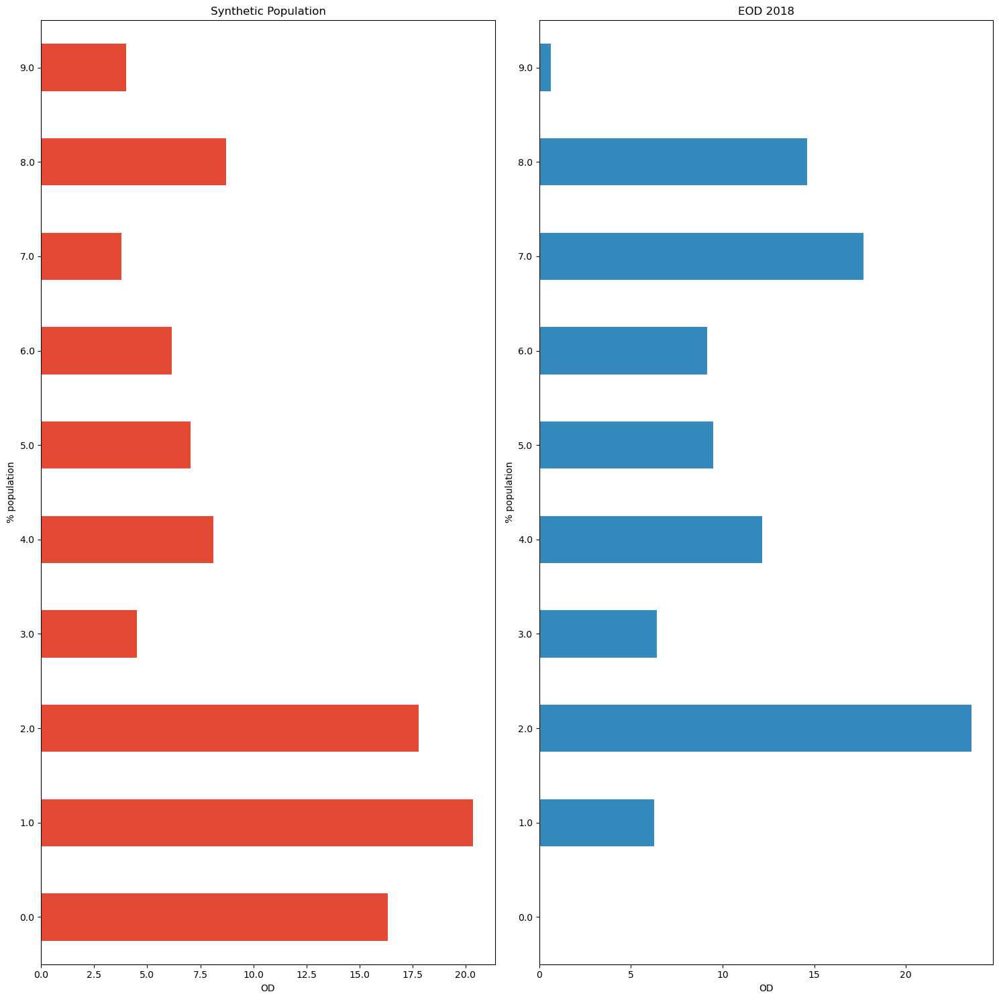

In [52]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 15))
colors = ["#e24a33", "#348abd"]
trip_ =trip[trip.r8_start.notnull()]
trip_ =trip_[trip.r8_end.notnull()]
trip_[['r8_end','w']].groupby('r8_end')['w'].sum().plot.barh(ax = axes[0],color = colors[0],title = 'Synthetic Population',legend = False,xlabel = 'OD',ylabel = '% population')
od_active[['r8dest','tw']].groupby('r8dest')['tw'].sum().plot.barh(ax = axes[1],color = colors[1],title = 'EOD 2018',legend = False,xlabel = 'OD',ylabel = '% population')
#plt.setp(axes,  yticks = [0,10,20,30,40,50,60])
fig.tight_layout()

In [54]:
od_active['od'] = od_active.srori.astype(float).astype(str)+"_"+od_active.srori.astype(float).astype(str)
od_observed = od_active[['od','tw']].groupby('od').sum()
trip['od'] = trip.CTUID_start.astype(float).astype(str)+"_"+trip.CTUID_end.astype(float).astype(str)
od_synthetic = trip[['od','w']].groupby('od').sum()


/var/folders/v6/djhtsx5d3198mkwrr88jb6tc0000gn/T/ipykernel_74620/2248871713.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_active['od'] = od_active.srori.astype(float).astype(str)+"_"+od_active.srori.astype(float).astype(str)


In [58]:
od_synthetic

,w
od,
4620001.0_4620001.0,0.003680
4620001.0_4620002.0,0.003312
4620001.0_4620003.0,0.001104
4620001.0_4620004.0,0.002086
4620001.0_4620005.0,0.002699
...,...
nan_4620853.03,0.000123
nan_4620855.03,0.000031
nan_4620863.02,0.000031
